# Telecom Churn using Logical regression

#### In the telecom industry, customers are able to choose from multiple service providers and actively switch from one operator to another. In this highly competitive market, the telecommunications industry experiences an average of 15-25% annual churn rate. Given the fact that it costs 5-10 times more to acquire a new customer than to retain an existing one, customer retention has now become even more important than customer acquisition.

###### For many incumbent operators, retaining high profitable customers is the number one business goal. To reduce customer churn, telecom companies need to predict which customers are at high risk of churn.
###### Lets analyze customer-level data of a leading telecom firm, and build predictive models to identify customers at high risk of churn.

In [159]:
#Importing Pandas and NumPy
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
from sklearn import metrics

In [62]:
# Importing train, test and 
train = pd.read_csv("train.csv")
test = pd.read_csv("test.csv")
summary = pd.read_csv("sample.csv")

In [63]:
train.head()

,id,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,churn_probability
0,0,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,31.277,87.009,7.527,48.58,124.38,1.29,32.24,96.68,2.33,0.00,0.0,0.0,0.00,0.0,0.00,2.23,0.00,0.28,5.29,16.04,2.33,0.00,0.00,0.00,0.00,0.00,0.00,7.53,16.04,2.61,46.34,124.38,1.01,18.75,80.61,0.0,0.00,0.0,0.0,0.0,0.0,0.0,65.09,204.99,1.01,0.0,0.0,0.0,8.20,0.63,0.00,0.38,0.0,0.0,81.21,221.68,3.63,2.43,3.68,7.79,0.83,21.08,16.91,0.00,0.00,0.00,3.26,24.76,24.71,0.00,7.61,0.21,7.46,19.96,14.96,0.0,0.0,0.0,0.0,0.0,0.0,7.46,27.58,15.18,11.84,53.04,40.56,0.0,0.0,0.66,0.0,0.0,0.0,1.11,0.69,0.00,3,2,2,77,65,10,65,65,10,6/22/2014,7/10/2014,8/24/2014,65,65,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.00,0.00,0.0,0.00,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,1958,0.0,0.0,0.0,0
1,1,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,0.000,122.787,42.953,0.00,0.00,0.00,0.00,25.99,30.89,0.00,0.0,0.0,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,22.01,29.79,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.00,30.73,31.66,0.00,0.0,0.0,0.00,30.73,31.66,1.68,19.09,10.53,1.41,18.68,11.09,0.35,1.66,3.40,3.44,39.44,25.03,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,3.44,39.44,25.04,0.0,0.0,0.01,0.0,0.0,0.0,0.00,0.00,0.00,3,4,5,0,145,50,0,145,50,6/12/2014,7/10/2014,8/26/2014,0,0,0,NaN,7/8/2014,NaN,NaN,1.0,NaN,NaN,145.0,NaN,NaN,0.0,NaN,NaN,1.0,NaN,Na

In [64]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69999 entries, 0 to 69998
Columns: 172 entries, id to churn_probability
dtypes: float64(135), int64(28), object(9)
memory usage: 91.9+ MB


In [65]:
train['churn_probability'].value_counts()

0    62867
1     7132
Name: churn_probability, dtype: int64

In [66]:
summary.head()

,id,churn_probability
0,69999,0
1,70000,0
2,70001,0
3,70002,0
4,70003,0


In [67]:
train['circle_id'].value_counts()

109    69999
Name: circle_id, dtype: int64

In [68]:
#Dropping circle_id as it contains only one value
train = train.drop(['circle_id'], 1)
test = test.drop(['circle_id'], 1)

/var/folders/gg/7k4yc41x7613l28wqf24kd0m0000gn/T/ipykernel_15068/1043924734.py:2: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  train = train.drop(['circle_id'], 1)
/var/folders/gg/7k4yc41x7613l28wqf24kd0m0000gn/T/ipykernel_15068/1043924734.py:3: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  test = test.drop(['circle_id'], 1)


In [69]:
train.head()

,id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,churn_probability
0,0,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,31.277,87.009,7.527,48.58,124.38,1.29,32.24,96.68,2.33,0.00,0.0,0.0,0.00,0.0,0.00,2.23,0.00,0.28,5.29,16.04,2.33,0.00,0.00,0.00,0.00,0.00,0.00,7.53,16.04,2.61,46.34,124.38,1.01,18.75,80.61,0.0,0.00,0.0,0.0,0.0,0.0,0.0,65.09,204.99,1.01,0.0,0.0,0.0,8.20,0.63,0.00,0.38,0.0,0.0,81.21,221.68,3.63,2.43,3.68,7.79,0.83,21.08,16.91,0.00,0.00,0.00,3.26,24.76,24.71,0.00,7.61,0.21,7.46,19.96,14.96,0.0,0.0,0.0,0.0,0.0,0.0,7.46,27.58,15.18,11.84,53.04,40.56,0.0,0.0,0.66,0.0,0.0,0.0,1.11,0.69,0.00,3,2,2,77,65,10,65,65,10,6/22/2014,7/10/2014,8/24/2014,65,65,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.00,0.00,0.0,0.00,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,1958,0.0,0.0,0.0,0
1,1,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,0.000,122.787,42.953,0.00,0.00,0.00,0.00,25.99,30.89,0.00,0.0,0.0,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,22.01,29.79,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.00,30.73,31.66,0.00,0.0,0.0,0.00,30.73,31.66,1.68,19.09,10.53,1.41,18.68,11.09,0.35,1.66,3.40,3.44,39.44,25.03,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,3.44,39.44,25.04,0.0,0.0,0.01,0.0,0.0,0.0,0.00,0.00,0.00,3,4,5,0,145,50,0,145,50,6/12/2014,7/10/2014,8/26/2014,0,0,0,NaN,7/8/2014,NaN,NaN,1.0,NaN,NaN,145.0,NaN,NaN,0.0,NaN,NaN,1.0,NaN,NaN,145.0,NaN,0.0,35

In [70]:
#Removing all the columns which have just one value in all the rows
for col in train.columns:
    if train[col].nunique() == 1:
        train.drop(col,inplace=True,axis=1)

In [71]:
for col in test.columns:
    if test[col].nunique() == 1:
        test.drop(col,inplace=True,axis=1)

In [72]:
train.head()

,id,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,churn_probability
0,0,31.277,87.009,7.527,48.58,124.38,1.29,32.24,96.68,2.33,0.00,0.0,0.0,0.00,0.0,0.00,2.23,0.00,0.28,5.29,16.04,2.33,0.00,0.00,0.00,0.00,0.00,0.00,7.53,16.04,2.61,46.34,124.38,1.01,18.75,80.61,0.0,0.00,0.0,0.0,65.09,204.99,1.01,0.0,0.0,0.0,8.20,0.63,0.00,0.38,0.0,0.0,81.21,221.68,3.63,2.43,3.68,7.79,0.83,21.08,16.91,0.00,0.00,0.00,3.26,24.76,24.71,0.00,7.61,0.21,7.46,19.96,14.96,0.0,0.0,0.0,7.46,27.58,15.18,11.84,53.04,40.56,0.0,0.0,0.66,0.0,0.0,0.0,1.11,0.69,0.00,3,2,2,77,65,10,65,65,10,6/22/2014,7/10/2014,8/24/2014,65,65,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.00,0.00,0.0,0.00,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,1958,0.0,0.0,0.0,0
1,1,0.000,122.787,42.953,0.00,0.00,0.00,0.00,25.99,30.89,0.00,0.0,0.0,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,22.01,29.79,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.00,30.73,31.66,0.00,0.0,0.0,0.00,30.73,31.66,1.68,19.09,10.53,1.41,18.68,11.09,0.35,1.66,3.40,3.44,39.44,25.03,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.00,0.00,0.00,3.44,39.44,25.04,0.0,0.0,0.01,0.0,0.0,0.0,0.00,0.00,0.00,3,4,5,0,145,50,0,145,50,6/12/2014,7/10/2014,8/26/2014,0,0,0,NaN,7/8/2014,NaN,NaN,1.0,NaN,NaN,145.0,NaN,NaN,0.0,NaN,NaN,1.0,NaN,NaN,145.0,NaN,0.0,352.91,0.00,0.0,3.96,0.0,NaN,122.07,NaN,NaN,122.08,NaN,NaN,0.0,NaN,0,0,0,0,0,0,0,1,0,0,0,0,NaN,1.0,NaN,710,0.0,0.0,0.0,0
2,2,60.806,103.176,0.000,0.53,15.93,0.00,53.99,82.05,0.00,0.00,0.0,0.0,0.00,0.0,0.00,0.53,12.98,0.00,24.11,0.00,0.00,0.00,0.00,0.00,2.14,0.00,0.00,24.64,12.98,0.00,0.00,2.94,0.00,28.94,82.05,0.0,0.00,0.0,0.0,28.94,84.99,0.0

In [73]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69999 entries, 0 to 69998
Columns: 159 entries, id to churn_probability
dtypes: float64(126), int64(27), object(6)
memory usage: 84.9+ MB


In [74]:
#Getting rid of id field as it is not needed for prediction
train = train.drop(['id'], 1)
test = test.drop(['id'], 1)

/var/folders/gg/7k4yc41x7613l28wqf24kd0m0000gn/T/ipykernel_15068/657536584.py:2: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  train = train.drop(['id'], 1)
/var/folders/gg/7k4yc41x7613l28wqf24kd0m0000gn/T/ipykernel_15068/657536584.py:3: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  test = test.drop(['id'], 1)


In [75]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69999 entries, 0 to 69998
Columns: 158 entries, arpu_6 to churn_probability
dtypes: float64(126), int64(26), object(6)
memory usage: 84.4+ MB


In [76]:
train = train.dropna(axis=1, how='all')

In [77]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69999 entries, 0 to 69998
Columns: 158 entries, arpu_6 to churn_probability
dtypes: float64(126), int64(26), object(6)
memory usage: 84.4+ MB


### Checking missing values and imputing them

In [78]:
train.isnull().sum()

arpu_6                  0
arpu_7                  0
arpu_8                  0
onnet_mou_6          2768
onnet_mou_7          2687
                     ... 
aon                     0
aug_vbc_3g              0
jul_vbc_3g              0
jun_vbc_3g              0
churn_probability       0
Length: 158, dtype: int64

In [79]:
list = train.columns[train.isnull().any()]

In [80]:
# List of columns with missing values
list

Index(['onnet_mou_6', 'onnet_mou_7', 'onnet_mou_8', 'offnet_mou_6',
       'offnet_mou_7', 'offnet_mou_8', 'roam_ic_mou_6', 'roam_ic_mou_7',
       'roam_ic_mou_8', 'roam_og_mou_6',
       ...
       'arpu_3g_8', 'arpu_2g_6', 'arpu_2g_7', 'arpu_2g_8', 'night_pck_user_6',
       'night_pck_user_7', 'night_pck_user_8', 'fb_user_6', 'fb_user_7',
       'fb_user_8'],
      dtype='object', length=114)

In [81]:
for col in list:
    print(col)

onnet_mou_6
onnet_mou_7
onnet_mou_8
offnet_mou_6
offnet_mou_7
offnet_mou_8
roam_ic_mou_6
roam_ic_mou_7
roam_ic_mou_8
roam_og_mou_6
roam_og_mou_7
roam_og_mou_8
loc_og_t2t_mou_6
loc_og_t2t_mou_7
loc_og_t2t_mou_8
loc_og_t2m_mou_6
loc_og_t2m_mou_7
loc_og_t2m_mou_8
loc_og_t2f_mou_6
loc_og_t2f_mou_7
loc_og_t2f_mou_8
loc_og_t2c_mou_6
loc_og_t2c_mou_7
loc_og_t2c_mou_8
loc_og_mou_6
loc_og_mou_7
loc_og_mou_8
std_og_t2t_mou_6
std_og_t2t_mou_7
std_og_t2t_mou_8
std_og_t2m_mou_6
std_og_t2m_mou_7
std_og_t2m_mou_8
std_og_t2f_mou_6
std_og_t2f_mou_7
std_og_t2f_mou_8
std_og_mou_6
std_og_mou_7
std_og_mou_8
isd_og_mou_6
isd_og_mou_7
isd_og_mou_8
spl_og_mou_6
spl_og_mou_7
spl_og_mou_8
og_others_6
og_others_7
og_others_8
loc_ic_t2t_mou_6
loc_ic_t2t_mou_7
loc_ic_t2t_mou_8
loc_ic_t2m_mou_6
loc_ic_t2m_mou_7
loc_ic_t2m_mou_8
loc_ic_t2f_mou_6
loc_ic_t2f_mou_7
loc_ic_t2f_mou_8
loc_ic_mou_6
loc_ic_mou_7
loc_ic_mou_8
std_ic_t2t_mou_6
std_ic_t2t_mou_7
std_ic_t2t_mou_8
std_ic_t2m_mou_6
std_ic_t2m_mou_7
std_ic_t2m_mou_

In [82]:
train['onnet_mou_6'].value_counts

<bound method IndexOpsMixin.value_counts of 0         48.58
1          0.00
2          0.53
3          7.26
4         21.28
          ...  
69994      0.00
69995    116.54
69996     77.13
69997     14.01
69998      0.00
Name: onnet_mou_6, Length: 69999, dtype: float64>

In [83]:
#Filling missing values with 0 as the value 0 is noticed in other rows as well where there are no calls within the same operator network 
train[['onnet_mou_6', 'onnet_mou_7', 'onnet_mou_8']] = train[['onnet_mou_6', 'onnet_mou_7', 'onnet_mou_8']].fillna(0)
test[['onnet_mou_6', 'onnet_mou_7', 'onnet_mou_8']] = test[['onnet_mou_6', 'onnet_mou_7', 'onnet_mou_8']].fillna(0)

In [84]:
#Filling missing values with 0 as the value 0 is noticed in other rows as well where there are no calls outside the operator T network
train[['offnet_mou_6', 'offnet_mou_7', 'offnet_mou_8']] = train[['offnet_mou_6', 'offnet_mou_7', 'offnet_mou_8']].fillna(0)
test[['offnet_mou_6', 'offnet_mou_7', 'offnet_mou_8']] = test[['offnet_mou_6', 'offnet_mou_7', 'offnet_mou_8']].fillna(0)

In [86]:
#Filling missing values in some more columns.

train[['roam_ic_mou_6', 'roam_ic_mou_7', 'roam_ic_mou_8']] = train[['roam_ic_mou_6', 'roam_ic_mou_7', 'roam_ic_mou_8']].fillna(0)
test[['roam_ic_mou_6', 'roam_ic_mou_7', 'roam_ic_mou_8']] = test[['roam_ic_mou_6', 'roam_ic_mou_7', 'roam_ic_mou_8']].fillna(0)

In [87]:
train[['roam_og_mou_6', 'roam_og_mou_7', 'roam_og_mou_8']] = train[['roam_og_mou_6', 'roam_og_mou_7', 'roam_og_mou_8']].fillna(0)
test[['roam_og_mou_6', 'roam_og_mou_7', 'roam_og_mou_8']] = test[['roam_og_mou_6', 'roam_og_mou_7', 'roam_og_mou_8']].fillna(0)

In [93]:
train[['loc_og_t2t_mou_6','loc_og_t2t_mou_7','loc_og_t2t_mou_8','loc_og_t2m_mou_6','loc_og_t2m_mou_7','loc_og_t2m_mou_8','loc_og_t2f_mou_6','loc_og_t2f_mou_7','loc_og_t2f_mou_8','loc_og_t2c_mou_6','loc_og_t2c_mou_7','loc_og_t2c_mou_8']] = train[['loc_og_t2t_mou_6','loc_og_t2t_mou_7','loc_og_t2t_mou_8','loc_og_t2m_mou_6','loc_og_t2m_mou_7','loc_og_t2m_mou_8','loc_og_t2f_mou_6','loc_og_t2f_mou_7','loc_og_t2f_mou_8','loc_og_t2c_mou_6','loc_og_t2c_mou_7','loc_og_t2c_mou_8']].fillna(0)
test[['loc_og_t2t_mou_6','loc_og_t2t_mou_7','loc_og_t2t_mou_8','loc_og_t2m_mou_6','loc_og_t2m_mou_7','loc_og_t2m_mou_8','loc_og_t2f_mou_6','loc_og_t2f_mou_7','loc_og_t2f_mou_8','loc_og_t2c_mou_6','loc_og_t2c_mou_7','loc_og_t2c_mou_8']] = test[['loc_og_t2t_mou_6','loc_og_t2t_mou_7','loc_og_t2t_mou_8','loc_og_t2m_mou_6','loc_og_t2m_mou_7','loc_og_t2m_mou_8','loc_og_t2f_mou_6','loc_og_t2f_mou_7','loc_og_t2f_mou_8','loc_og_t2c_mou_6','loc_og_t2c_mou_7','loc_og_t2c_mou_8']].fillna(0)

In [96]:
#Creating a df of those columns which have null values just to get the numbers and types.
obj = train[train.columns[train.isnull().any()]]

In [97]:
obj.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69999 entries, 0 to 69998
Data columns (total 90 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   loc_og_mou_6              67231 non-null  float64
 1   loc_og_mou_7              67312 non-null  float64
 2   loc_og_mou_8              66296 non-null  float64
 3   std_og_t2t_mou_6          67231 non-null  float64
 4   std_og_t2t_mou_7          67312 non-null  float64
 5   std_og_t2t_mou_8          66296 non-null  float64
 6   std_og_t2m_mou_6          67231 non-null  float64
 7   std_og_t2m_mou_7          67312 non-null  float64
 8   std_og_t2m_mou_8          66296 non-null  float64
 9   std_og_t2f_mou_6          67231 non-null  float64
 10  std_og_t2f_mou_7          67312 non-null  float64
 11  std_og_t2f_mou_8          66296 non-null  float64
 12  std_og_mou_6              67231 non-null  float64
 13  std_og_mou_7              67312 non-null  float64
 14  std_og

In [98]:
for col in train:
    if train[col].dtype == 'float':
        train[col] = train[col].fillna(0)

for col in test:
    if test[col].dtype == 'float':
        test[col] = test[col].fillna(0)        

In [100]:
train.columns[train.isnull().any()]

Index(['date_of_last_rech_6', 'date_of_last_rech_7', 'date_of_last_rech_8',
       'date_of_last_rech_data_6', 'date_of_last_rech_data_7',
       'date_of_last_rech_data_8'],
      dtype='object')

In [104]:
train['date_of_last_rech_data_6'].isnull().sum()

52431

In [107]:
#Dropping date_of_last_rech_data_6 column as there are too many null values
train = train.drop(['date_of_last_rech_data_6'], axis = 1)
test = test.drop(['date_of_last_rech_data_6'], axis = 1)

In [110]:
train['date_of_last_rech_data_8'].isnull().sum()

51582

In [111]:
#Dropping date_of_last_rech_data_7 and date_of_last_rech_data_8 column as well
train = train.drop(['date_of_last_rech_data_7'], axis = 1)
test = test.drop(['date_of_last_rech_data_7'], axis = 1)
train = train.drop(['date_of_last_rech_data_8'], axis = 1)
test = test.drop(['date_of_last_rech_data_8'], axis = 1)

In [112]:
# Filling the missing value with 15th of the respective month

train[['date_of_last_rech_6']] = train[['date_of_last_rech_6']].fillna('6/15/2014')
test[['date_of_last_rech_6']] = test[['date_of_last_rech_6']].fillna('6/15/2014')
train[['date_of_last_rech_7']] = train[['date_of_last_rech_7']].fillna('6/15/2014')
test[['date_of_last_rech_7']] = test[['date_of_last_rech_7']].fillna('6/15/2014')
train[['date_of_last_rech_8']] = train[['date_of_last_rech_8']].fillna('6/15/2014')
test[['date_of_last_rech_8']] = test[['date_of_last_rech_8']].fillna('6/15/2014')

In [113]:
obj = train[train.columns[train.isnull().any()]]
obj

""
0
1
2
3
4
...
69994
69995
69996
69997


### No null values.

In [116]:
# Lets fetch the column which are of type object
train.select_dtypes(include=['object'])

,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8
0,6/22/2014,7/10/2014,8/24/2014
1,6/12/2014,7/10/2014,8/26/2014
2,6/11/2014,7/22/2014,8/24/2014
3,6/15/2014,7/21/2014,8/25/2014
4,6/25/2014,7/26/2014,8/30/2014
...,...,...,...
69994,6/18/2014,7/31/2014,8/31/2014
69995,6/28/2014,7/31/2014,8/27/2014
69996,6/25/2014,7/30/2014,8/29/2014
69997,6/29/2014,7/19/2014,8/26/2014


In [122]:
# We just need the day of the month as the data is already segregated among months.
train['day_of_last_rech_6'] = train['date_of_last_rech_6'].str.split('/').str[1]
train['day_of_last_rech_7'] = train['date_of_last_rech_7'].str.split('/').str[1]
train['day_of_last_rech_8'] = train['date_of_last_rech_8'].str.split('/').str[1]

In [123]:
test['day_of_last_rech_6'] = test['date_of_last_rech_6'].str.split('/').str[1]
test['day_of_last_rech_7'] = test['date_of_last_rech_7'].str.split('/').str[1]
test['day_of_last_rech_8'] = test['date_of_last_rech_8'].str.split('/').str[1]

In [124]:
train['day_of_last_rech_6'].value_counts

<bound method IndexOpsMixin.value_counts of 0        22
1        12
2        11
3        15
4        25
         ..
69994    18
69995    28
69996    25
69997    29
69998    19
Name: day_of_last_rech_6, Length: 69999, dtype: object>

In [125]:
#Dropping the date_of_last_rech columns
train = train.drop(['date_of_last_rech_6'], axis = 1)
test = test.drop(['date_of_last_rech_6'], axis = 1)
train = train.drop(['date_of_last_rech_7'], axis = 1)
test = test.drop(['date_of_last_rech_7'], axis = 1)
train = train.drop(['date_of_last_rech_8'], axis = 1)
test = test.drop(['date_of_last_rech_8'], axis = 1)

In [126]:
train.head()

,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,churn_probability,day_of_last_rech_6,day_of_last_rech_7,day_of_last_rech_8
0,31.277,87.009,7.527,48.58,124.38,1.29,32.24,96.68,2.33,0.00,0.0,0.0,0.00,0.0,0.00,2.23,0.00,0.28,5.29,16.04,2.33,0.00,0.00,0.00,0.00,0.00,0.00,7.53,16.04,2.61,46.34,124.38,1.01,18.75,80.61,0.0,0.00,0.0,0.0,65.09,204.99,1.01,0.0,0.0,0.0,8.20,0.63,0.00,0.38,0.0,0.0,81.21,221.68,3.63,2.43,3.68,7.79,0.83,21.08,16.91,0.00,0.00,0.00,3.26,24.76,24.71,0.00,7.61,0.21,7.46,19.96,14.96,0.0,0.0,0.0,7.46,27.58,15.18,11.84,53.04,40.56,0.0,0.0,0.66,0.0,0.0,0.0,1.11,0.69,0.00,3,2,2,77,65,10,65,65,10,65,65,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,1958,0.0,0.0,0.0,0,22,10,24
1,0.000,122.787,42.953,0.00,0.00,0.00,0.00,25.99,30.89,0.00,0.0,0.0,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,22.01,29.79,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.00,30.73,31.66,0.00,0.0,0.0,0.00,30.73,31.66,1.68,19.09,10.53,1.41,18.68,11.09,0.35,1.66,3.40,3.44,39.44,25.03,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.00,0.00,0.00,3.44,39.44,25.04,0.0,0.0,0.01,0.0,0.0,0.0,0.00,0.00,0.00,3,4,5,0,145,50,0,145,50,0,0,0,0.0,1.0,0.0,0.0,145.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,145.0,0.0,0.0,352.91,0.00,0.0,3.96,0.0,0.0,122.07,0.0,0.0,122.08,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,1,0,0,0,0,0.0,1.0,0.0,710,0.0,0.0,0.0,0,12,10,26
2,60.806,103.176,0.000,0.53,15.93,0.00,53.99,82.05,0.00,0.00,0.0,0.0,0.00,0.0,0.00,0.53,12.98,0.00,24.11,0.00,0.00,0.00,0.00,0.00,2.14,0.00,0.00,24.64,12.98,0.00,0.00,2.94,0.00,28.94,82.05,0.0,0.00,0.0,0.0,28.94,84.99,0.00,0.0,0.0,0.0,2.89,1.38,0.00,0.00,0.0,0.0,56.49,99.36,0.00,4.51,6.16,6.49,89.86,25.18,23.51,0.00,0.00,0.00,94.38,31.34,30.01,11.69,0.00,0.00,18.21,2.48,6.38

In [127]:
train.select_dtypes(include=['object'])

,day_of_last_rech_6,day_of_last_rech_7,day_of_last_rech_8
0,22,10,24
1,12,10,26
2,11,22,24
3,15,21,25
4,25,26,30
...,...,...,...
69994,18,31,31
69995,28,31,27
69996,25,30,29
69997,29,19,26


In [128]:
#Lets convert these to integers
train["day_of_last_rech_6"] = train["day_of_last_rech_6"].astype("int32")
train["day_of_last_rech_7"] = train["day_of_last_rech_7"].astype("int32")
train["day_of_last_rech_8"] = train["day_of_last_rech_8"].astype("int32")

In [129]:
test["day_of_last_rech_6"] = test["day_of_last_rech_6"].astype("int32")
test["day_of_last_rech_7"] = test["day_of_last_rech_7"].astype("int32")
test["day_of_last_rech_8"] = test["day_of_last_rech_8"].astype("int32")

In [133]:
# Lets check the correlation between among the columns
plt.figure(figsize = (100,100))        
sns.heatmap(train.corr(),annot = True)

<AxesSubplot:>

In [134]:
# Looking at the heatmap, sachet_2g columns are hoghly correlated with total_rech_data and count_rech_2g columns. Lets drop them.
train = train.drop(['sachet_2g_6'], axis = 1)
test = test.drop(['sachet_2g_6'], axis = 1)
train = train.drop(['sachet_2g_7'], axis = 1)
test = test.drop(['sachet_2g_7'], axis = 1)
train = train.drop(['sachet_2g_8'], axis = 1)
test = test.drop(['sachet_2g_8'], axis = 1)

In [135]:
# total_rech_amt columns are correlated to arpu columns.
train = train.drop(['total_rech_amt_6'], axis = 1)
test = test.drop(['total_rech_amt_6'], axis = 1)
train = train.drop(['total_rech_amt_7'], axis = 1)
test = test.drop(['total_rech_amt_7'], axis = 1)
train = train.drop(['total_rech_amt_8'], axis = 1)
test = test.drop(['total_rech_amt_8'], axis = 1)

In [136]:
# Lets check the correlation one more time
plt.figure(figsize = (100,100))        
sns.heatmap(train.corr(),annot = True)

<AxesSubplot:>

In [137]:
# onnet_mou columns are highly corelated with std_og_t2t_mou columns
train = train.drop(['std_og_t2t_mou_6'], axis = 1)
test = test.drop(['std_og_t2t_mou_6'], axis = 1)
train = train.drop(['std_og_t2t_mou_7'], axis = 1)
test = test.drop(['std_og_t2t_mou_7'], axis = 1)
train = train.drop(['std_og_t2t_mou_8'], axis = 1)
test = test.drop(['std_og_t2t_mou_8'], axis = 1)

In [138]:
# offnet_mou columns are highly corelated with std_og_t2m_mou columns
train = train.drop(['std_og_t2m_mou_6'], axis = 1)
test = test.drop(['std_og_t2m_mou_6'], axis = 1)
train = train.drop(['std_og_t2m_mou_7'], axis = 1)
test = test.drop(['std_og_t2m_mou_7'], axis = 1)
train = train.drop(['std_og_t2m_mou_8'], axis = 1)
test = test.drop(['std_og_t2m_mou_8'], axis = 1)

In [139]:
#loc_og_mou_7 is correlated to loc_og_mou_6 and 8
train = train.drop(['loc_og_mou_7'], axis = 1)
test = test.drop(['loc_og_mou_7'], axis = 1)

In [140]:
# Lets check the correlation one more time
plt.figure(figsize = (100,100))        
sns.heatmap(train.corr(),annot = True)

<AxesSubplot:>

In [141]:
#isd_og_mou columns are highly correlated to each other
train = train.drop(['isd_og_mou_6'], axis = 1)
test = test.drop(['isd_og_mou_6'], axis = 1)
train = train.drop(['isd_og_mou_7'], axis = 1)
test = test.drop(['isd_og_mou_7'], axis = 1)

In [142]:
#total_ic_mou is highly correlated with loc_ic_mou
train = train.drop(['loc_ic_mou_6'], axis = 1)
test = test.drop(['loc_ic_mou_6'], axis = 1)
train = train.drop(['loc_ic_mou_7'], axis = 1)
test = test.drop(['loc_ic_mou_7'], axis = 1)
train = train.drop(['loc_ic_mou_8'], axis = 1)
test = test.drop(['loc_ic_mou_8'], axis = 1)

In [143]:
#arpu_3g and arpu_2g are correlated
train = train.drop(['arpu_2g_6'], axis = 1)
test = test.drop(['arpu_2g_6'], axis = 1)
train = train.drop(['arpu_2g_7'], axis = 1)
test = test.drop(['arpu_2g_7'], axis = 1)
train = train.drop(['arpu_2g_8'], axis = 1)
test = test.drop(['arpu_2g_8'], axis = 1)

In [144]:
#count_rech_2g and total_rech_data are correlated
train = train.drop(['total_rech_data_6'], axis = 1)
test = test.drop(['total_rech_data_6'], axis = 1)
train = train.drop(['total_rech_data_7'], axis = 1)
test = test.drop(['total_rech_data_7'], axis = 1)
train = train.drop(['total_rech_data_8'], axis = 1)
test = test.drop(['total_rech_data_8'], axis = 1)

In [145]:
# Lets check the correlation one more time
plt.figure(figsize = (100,100))        
sns.heatmap(train.corr(),annot = True)

<AxesSubplot:>

### Data looks good. Lets prepare data for modelling

In [146]:
train_backup = train
#Lets separate the dependent and independent variables.
# split into X and y
y = train_backup.pop('churn_probability')
X = train_backup


In [147]:
# Scaling the features
from sklearn.preprocessing import scale

cols = X.columns
X = pd.DataFrame(scale(X))
X.columns = cols
X.columns

Index(['arpu_6', 'arpu_7', 'arpu_8', 'onnet_mou_6', 'onnet_mou_7',
       'onnet_mou_8', 'offnet_mou_6', 'offnet_mou_7', 'offnet_mou_8',
       'roam_ic_mou_6',
       ...
       'fb_user_6', 'fb_user_7', 'fb_user_8', 'aon', 'aug_vbc_3g',
       'jul_vbc_3g', 'jun_vbc_3g', 'day_of_last_rech_6', 'day_of_last_rech_7',
       'day_of_last_rech_8'],
      dtype='object', length=130)

In [150]:
X_train = sm.add_constant(X)
logm = sm.GLM(y,X_train, family = sm.families.Binomial())
res = logm.fit()
res.summary()

/Users/personal/opt/anaconda3/lib/python3.9/site-packages/statsmodels/genmod/families/links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
/Users/personal/opt/anaconda3/lib/python3.9/site-packages/statsmodels/genmod/families/family.py:1014: RuntimeWarning: divide by zero encountered in log
  special.gammaln(n - y + 1) + y * np.log(mu / (1 - mu + 1e-20)) +
/Users/personal/opt/anaconda3/lib/python3.9/site-packages/statsmodels/genmod/families/family.py:1014: RuntimeWarning: invalid value encountered in multiply
  special.gammaln(n - y + 1) + y * np.log(mu / (1 - mu + 1e-20)) +


<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:      churn_probability   No. Observations:                69999
Model:                            GLM   Df Residuals:                    69871
Model Family:                Binomial   Df Model:                          127
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Sun, 04 Jun 2023   Deviance:                   6.6057e+05
Time:                        19:37:05   Pearson chi2:                 3.23e+19
No. Iterations:                   100   Pseudo R-squ. (CS):                nan
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const              -8.633e+14   2.54e+05   -3.4e+09      0.000   -8.63e+14   -8.63e+14
arpu_6              2.467e+14   8.25e+05   2.99e+08      0.000    2.47e+14    2.47e+14
arpu_7              5.854e+13   8.73e+05    6.7e+07      0.000    5.85e+13    5.85e+13
arpu_8             -2.393e+13   7.91e+05  -3.02e+07      0.000   -2.39e+13   -2.39e+13
onnet_mou_6         1.021e+13   1.38e+07   7.39e+05      0.000    1.02e+13    1.02e+13
onnet_mou_7         -9.72e+14   1.35e+07   -7.2e+07      0.000   -9.72e+14   -9.72e+14
onnet_mou_8        -7.491e+13   1.31e+07  -5.74e+06      0.000   -7.49e+13   -7.49e+13
offnet_mou_6        2.279e+13   1.46e+07   1.56e+06      0.000    2.28e+13    2.28e+13
offnet_mou_7       -9.992e+14    1.4e+07  -7.14e+07      0.000   -9.99e+14   -9.99e+14
offnet_mou_8       -1.088e+14   1.36e+07     -8e+06      0.000   -1.09e+14   -1.09e+14
roam_ic_mou_6       3.654e+13   3.43e+05   1.06e+08      0.000    3.65e+13    3.65e+13
roam_ic_mou_7       2.991e+13   4.02e+05   7.45e+07      0.000    2.99e+13    2.99e+13
roam_ic_mou_8       -1.23e+13   3.75e+05  -3.28e+07      0.000   -1.23e+13   -1.23e+13
roam_og_mou_6      -3.032e+12   3.41e+06   -8.9e+05      0.000   -3.03e+12   -3.03e+12
roam_og_mou_7       2.067e+14   2.56e+06   8.06e+07      0.000    2.07e+14    2.07e+14
roam_og_mou_8       2.645e+13   2.72e+06   9.71e+06      0.000    2.64e+13    2.64e+13
loc_og_t2t_mou_6    7.837e+17   6.73e+09   1.16e+08      0.000    7.84e+17    7.84e+17
loc_og_t2t_mou_7   -1.392e+14   5.99e+06  -2.32e+07      0.000   -1.39e+14   -1.39e+14
loc_og_t2t_mou_8    2.226e+18   6.85e+09   3.25e+08      0.000    2.23e+18    2.23e+18
loc_og_t2m_mou_6     8.45e+17   7.26e+09   1.16e+08      0.000    8.45e+17    8.45e+17
loc_og_t2m_mou_7   -1.316e+14   5.93e+06  -2.22e+07      0.000   -1.32e+14   -1.32e+14
loc_og_t2m_mou_8    2.231e+18   6.87e+09   3.25e+08      0.000    2.23e+18    2.23e+18
loc_og_t2f_mou_6    6.909e+16   5.94e+08   1.16e+08      0.000    6.91e+16    6.91e+16
loc_og_t2f_mou_7    1.027e+13   7.07e+05   1.45e+07      0.000    1.03e+13    1.03e+13
loc_og_t2f_mou_8    1.884e+17    5.8e+08   3.25e+08      0.000    1.88e+17    1.88e+17
loc_og_t2c_mou_6   -2.083e+13   3.23e+05  -6.46e+07      0.000   -2.08e+13   -2.08e+13
loc_og_t2c_mou_7    2.078e+13   3.42e+05   6.08e+07      0.000    2.08e+13    2.08e+13
loc_og_t2c_mou_8     1.41e+13   3.39e+05   4.16e+07      0.000    1.41e+13    1.41e+13
loc_og_mou_6       -1.313e+18   1.13e+10  -1.16e+08      0.000   -1.31e+18   -1.31e+18
loc_og_mou_8       -3.621e+17   1.46e+10  -2.48e+07      0.000   -3.62e+17   -3.62e+17
std_og_t2f_mou_6   -2.559e+13    3.5e+05  -7.32e+07      0.000   -2.56e+13   -2.56e+13
std_og_t2f_mou_7    6.499e+12   3.99e+05   1.63e+07      0.000     6.5e+12     6.5e+12
std_og_t2f_mou_8    4.016e+12   3.79e+

In [151]:
# Getting the predicted values on the train set
y_pred = res.predict(X_train)
y_pred[:10]

/Users/personal/opt/anaconda3/lib/python3.9/site-packages/statsmodels/genmod/families/links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


0    0.0
1    0.0
2    1.0
3    0.0
4    0.0
5    0.0
6    0.0
7    0.0
8    1.0
9    0.0
dtype: float64

In [153]:
y_pred.describe()

count    69999.000000
mean         0.151688
std          0.358721
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.000000
dtype: float64

In [154]:
y_pred_shape = y_pred.values.reshape(-1)
y_pred_shape[:10]

array([0., 0., 1., 0., 0., 0., 0., 0., 1., 0.])

In [155]:
y_train_pred_final = pd.DataFrame({'Churn':y.values, 'Churn_Prob':y_pred_shape})
y_train_pred_final['CustID'] = y.index
y_train_pred_final.head()

,Churn,Churn_Prob,CustID
0,0,0.0,0
1,0,0.0,1
2,0,1.0,2
3,0,0.0,3
4,0,0.0,4


In [156]:
y_train_pred_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69999 entries, 0 to 69998
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Churn       69999 non-null  int64  
 1   Churn_Prob  69999 non-null  float64
 2   CustID      69999 non-null  int64  
dtypes: float64(1), int64(2)
memory usage: 1.6 MB


In [157]:
#Changing Churn_Prob to int
y_train_pred_final["Churn_Prob"] = y_train_pred_final["Churn_Prob"].astype("int32")

In [158]:
y_train_pred_final.head()

,Churn,Churn_Prob,CustID
0,0,0,0
1,0,0,1
2,0,1,2
3,0,0,3
4,0,0,4


In [160]:
# Confusion matrix 
confusion = metrics.confusion_matrix(y_train_pred_final.Churn, y_train_pred_final.Churn_Prob )
print(confusion)

[[57538  5329]
 [ 1843  5289]]


In [161]:
# Let's check the overall accuracy.
print(metrics.accuracy_score(y_train_pred_final.Churn, y_train_pred_final.Churn_Prob))

0.8975413934484778


In [162]:
def draw_roc( actual, probs ):
    fpr, tpr, thresholds = metrics.roc_curve( actual, probs,
                                              drop_intermediate = False )
    auc_score = metrics.roc_auc_score( actual, probs )
    plt.figure(figsize=(6, 6))
    plt.plot( fpr, tpr, label='ROC curve (area = %0.2f)' % auc_score )
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic example')
    plt.legend(loc="lower right")
    plt.show()

    return fpr, tpr, thresholds

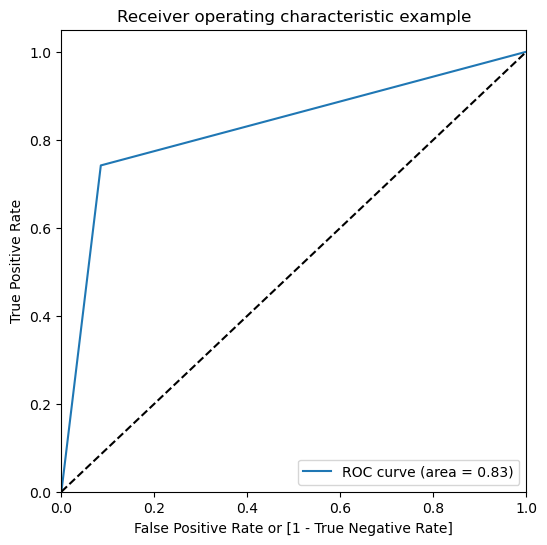

(array([0.        , 0.08476625, 1.        ]),
 array([0.        , 0.74158721, 1.        ]),
 array([2, 1, 0], dtype=int32))

In [163]:
draw_roc(y_train_pred_final.Churn, y_train_pred_final.Churn_Prob)

## Making predictions on the test set¶

In [165]:
test_backup = test
# Scaling the features
cols = test_backup.columns
test_backup = pd.DataFrame(scale(test_backup))
test_backup.columns = cols
test_backup.columns

Index(['arpu_6', 'arpu_7', 'arpu_8', 'onnet_mou_6', 'onnet_mou_7',
       'onnet_mou_8', 'offnet_mou_6', 'offnet_mou_7', 'offnet_mou_8',
       'roam_ic_mou_6',
       ...
       'fb_user_6', 'fb_user_7', 'fb_user_8', 'aon', 'aug_vbc_3g',
       'jul_vbc_3g', 'jun_vbc_3g', 'day_of_last_rech_6', 'day_of_last_rech_7',
       'day_of_last_rech_8'],
      dtype='object', length=130)

In [166]:
test_backup_sm = sm.add_constant(test_backup)

In [167]:
y_test_pred = res.predict(test_backup_sm)

/Users/personal/opt/anaconda3/lib/python3.9/site-packages/statsmodels/genmod/families/links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


In [168]:
# Converting y_pred to a dataframe which is an array
y_pred = pd.DataFrame(y_test_pred)

In [169]:
y_pred.head()

,0
0,1.0
1,0.0
2,1.0
3,0.0
4,1.0


In [170]:
y_pred = y_pred.rename(columns={ 0 : 'Churn_Prob'})

In [171]:
y_pred.head()

,Churn_Prob
0,1.0
1,0.0
2,1.0
3,0.0
4,1.0


In [172]:
#Changing Churn_Prob to int
y_pred["Churn_Prob"] = y_pred["Churn_Prob"].astype("int32")